# 本文件说明
- 主题概率模型

# 基本设置

In [1]:
import jieba
from jieba import analyse
import sys
import re
import time
import string
from sklearn import feature_extraction
from sklearn.pipeline import Pipeline,FeatureUnion
from sklearn.model_selection import GridSearchCV
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import CountVectorizer

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, chi2,mutual_info_classif,f_classif 
from sklearn.preprocessing import StandardScaler

import xgboost as xgb
from xgboost import XGBClassifier
from sklearn import metrics

from sklearn.base import BaseEstimator, TransformerMixin

%matplotlib inline
import numpy as np
import pandas as pd
import os
from sklearn.model_selection import train_test_split
from collections import Counter

from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import seaborn as sns

colors = sns.color_palette("Set2", 8)

import warnings
warnings.filterwarnings('ignore')

In [7]:
from toolkits.nlp.generate_keywords import generate_keywords
from toolkits.nlp import myclass_circ
from toolkits.nlp import myclass_cbrc
from toolkits.nlp import preprocess
from toolkits.setup.specific_func import set_ch_pd
set_ch_pd()

## 一些函数

In [42]:
def print_topic(topic_term, topic_id, feature_names, n_top_words):
    print("Topic # {:2d} ".format(topic_id))
    print(" ".join(vocabulary[i] for i in topic_term[topic_id].argsort()[:-n_top_words:-1]))

# 导入数据

In [5]:
label_dic={'监管':1,'行业':2,'产品销售':3,'资本市场':4,'公司内部管理':5,'消费服务':6,'其他相关报道':7,'噪音':8}
class_name_dict = {v: k for k, v in label_dic.items()}

In [8]:
# file_path = 'circ_result_class/corpus/'
file_path = 'cbrc_result_class/corpus/'

title_content, label = preprocess.title_content_label(file_path)

title num:  14192
['月线 反转 阴包 阳 原油 高 先空 股友 zevS 东方 财富网 博客', '汇乔 金色 名 售 价格 元 平方米']
content num:  14192
title_content num:  14192
label num:  14192
['噪音', '噪音', '噪音', '噪音', '噪音']


In [9]:
X_train, X_test, y_train, y_test = train_test_split(title_content, label, test_size=0.3, random_state=42)
print('训练集：',len(y_train))
print('训练集-各类数量：',Counter(y_train))
print('测试集：',len(y_test))
print('测试集-各类数量：',Counter(y_test))

训练集： 9934
训练集-各类数量： Counter({'噪音': 1924, '其他相关报道': 1430, '行业': 1252, '消费服务': 1183, '监管': 1133, '资本市场': 1123, '公司内部管理': 973, '产品销售': 916})
测试集： 4258
测试集-各类数量： Counter({'噪音': 797, '其他相关报道': 600, '行业': 534, '消费服务': 527, '监管': 507, '资本市场': 456, '公司内部管理': 442, '产品销售': 395})


## sklearn

In [17]:
from sklearn.feature_extraction.text import CountVectorizer

tf_vectorizer  = CountVectorizer(max_df=0.95, min_df=2)
tf_vectorizer.fit(X_train)

tf_train = tf_vectorizer.transform(X_train)
tf_test = tf_vectorizer.transform(X_test)

print(tf_train.shape)
print(tf_test.shape)

(9934, 71365)
(4258, 71365)


## gensim

In [13]:
from gensim import corpora, models

tokens = [t.split() for t in title_content]
# 得到单词的ID,统计单词出现的次数以及统计信息

dictionary = corpora.Dictionary(tokens)   
# dictionary.token2id         # 可以得到单词的id信息  <dict>

# 将dictionary转化为一个词袋，得到文档-单词矩阵
# 预处理完的分词结果
texts = [dictionary.doc2bow(text) for text in tokens]

# 文档的tf-idf形式(训练加转换的模式)
texts_tf_idf = models.TfidfModel(texts)[texts]   
# 逐行打印得到每篇文档的每个单词的TD-IDF的特征值
# for text in texts_tf_idf:  print text          

# LDA

## gensim

In [ ]:
lda = models.ldamodel.LdaModel(corpus=texts, id2word=dictionary, num_topics=3,update_every=0,passes=20)
texts_lda = lda[texts_tf_idf]
lda.print_topics(num_topics=3, num_words=4)
# print(lda.print_topics(num_topics=5, num_words=3))

## sklearn

In [18]:
from sklearn.decomposition import LatentDirichletAllocation

lda = LatentDirichletAllocation(n_topics=100, learning_method='batch', random_state=0)
lda.fit(tf_train)

3800.505173946505

### Inspect topics

In [34]:
print(lda.n_iter_)
print(lda.components_.shape)
print(lda.components_)
# print(lda.components_.sum(axis=1))

10
(100, 71365)
[[0.01       0.01       0.01       ... 0.01       0.01       0.01      ]
 [0.01       0.01       0.01       ... 0.01       0.01       0.01      ]
 [0.01       0.01       0.01       ... 0.01       0.01       0.01      ]
 ...
 [7.20965303 0.01       0.01       ... 0.01       0.01       0.01      ]
 [0.01       0.01       0.01       ... 0.01       0.01       0.01      ]
 [2.66775795 0.01       0.01       ... 0.01       0.01       0.01      ]]


In [43]:
topic_term = lda.components_  # 主题-词语分布矩阵
tf_feature_names = tf_vectorizer.get_feature_names()
print(tf_feature_names[:100:10])

n_top_words=20
tf_feature_names = tf_vectorizer.get_feature_names()
for i, _  in enumerate(topic_term):
    print_topic(topic_term, i, tf_feature_names, n_top_words)

['aa', 'abcd', 'acc', 'act', 'adam', 'adobe', 'advisers', 'after', 'ago', 'aig']
Topic #  0 
the 诈骗 to of in and 骗子 is that 信息 it 电信 you for 电话 短信 on 被骗 密码
Topic #  1 
住房 房价 房地产 城市 市场 楼市 租赁 公积金 购房 政策 买房 调控 贷款 房子 上涨 深圳 房贷 银行 购房者
Topic #  2 
活动 金融 宣传 知识 支行 普及 现场 防范 消费者 客户 分行 服务 社区 意识 支付 提升 主题 社会 工作人员
Topic #  3 
产品 投资 资金 项目 收益 专项 资产 保险资金 市场 风险 万亿元 长期 险资 报告 养老 发行 国有资产 情况 国务院
Topic #  4 
杠杆 中国 风险 市场 政府 金融机构 资产 发生 导致 去杠杆 美团 持续 选择 经济 未来 银行 兜底 违约 债务
Topic #  5 
评级 农商行 九江银行 前海人寿 大额存单 银行 该行 资产 风险 报告 穆迪 质量 不良贷款 投资 城商行 发行 汽车 主体 监管
Topic #  6 
投资 资产管理 计划 投资者 机构 经营 证券期货 管理 资产 资管 业务 风险 产品 证券 私募 兑付 资金 中国证监会 合同
Topic #  7 
停电 活动 线路 时间 报名 户外 公变 kv 费用 出发 退出 名称 计划 影响 电话 领队 微信 小区 地点
Topic #  8 
合作 协议 战略 发展 签署 中国 the 集团 项目 of 签约 仪式 一带 一路 国家 经济 支持 and 银行
Topic #  9 
图片 服务 志愿 滴滴 社会 组织 答案 单项 选择题 志愿者 解析 选择 沈阳 慈善 信息 公司 以太 录音 时间
Topic # 10 
农村 农业 支付 乡村 农民 服务 振兴 万元 建设 支持 创业 农户 村民 三农 项目 资金 提供 土地 农行
Topic # 11 
支行 员工 分行 客户 工作 业务 该行 网点 服务 行长 营销 管理 活动 数据 全行 邮储银行 提升 慰问 工行
Topic # 12 
预售 商品房 公司 市场 房地产 资金 发展 北上 机构 房屋 合同

### Inspect a document in the corpus

In [ ]:
docres_train = lda.transform(tf_train)
docres_test = lda.transform(tf_test)

In [24]:
print(docres_train.shape)

(9934, 100)


In [47]:
top_topics = (docres_train[1234]).argsort()[:-6:-1]
print(top_topics)
print()
print(X_train[1234])

[87 75 95 42 83]

A股 有望 迎来 银行 系 长期 资金 利于 提振 股市 信心 A股 有望 迎来 银行 系 长期 资金 利于 提振 股市 信心 来源 证券日报 作者 包 兴安 字号 小大 核心 提示 接受 记者 采访 专家 银行理财 子公司 发行 公募 产品 获准 投资 股市 A股 迎来 银行 系 长期 资金 有利于 提振 股市 信心 带动 资金 股市 徽商银行 近日 公告 称 进一步 推动 理财业务 发展 深化 理财 治理 体系 改革 该行 拟 设立 资管 子公司 包括 徽商银行 兴业银行 浦发银行 杭州银行 在内 家 银行 拟 设立 理财 子公司 接受 记者 采访 专家 银行理财 子公司 发行 公募 产品 获准 投资 股市 A股 迎来 银行 系 长期 资金 有利于 提振 股市 信心 带动 资金 股市 投资 股票 资管 机构 扩容 资管 行业 改革 原则 金融 细分 行业 资管 产品 监管 平等 差异 监管套利 通道 业务 东北 证券 固定 收益 分析师 刘辰涵 证券日报 记者 证券 行业 信托 行业 资管 产品 投资 股票 银行理财 子公司 发行 公募 产品 投资 股市 事实上 公平 符合 改革 思路 月 日 中共中央政治局 委员 国务院 副 总理 刘鹤 经济 金融热点 接受 记者 采访 刘鹤 采访 中 银行理财 子公司 资本 市场 投资 金融机构 科学合理 做好 股权 质押 融资 业务 风险管理 鼓励 地方 政府 管理 基金 私募 股权 基金 发展前景 公司 纾解 股权 质押 困难 同日 银保监会 发布 商业银行 理财 子公司 管理 办法 征求意见 稿 提出 前期 银行 私募 理财产品 投资 股票 公募 理财产品 公募 基金 间接 投资 股票 基础 进一步 子公司 发行 公募 理财产品 投资 股票 参照 资管 产品 监管 设置 理财产品 销售 起点 金额 稳 市场 措施 ldquo 银行理财 子公司 发行 公募 产品 投资 股市 贯彻落实 近期 决策层 稳定 资本 市场 恐慌 情绪 政策 目标 rdquo 苏宁 金融 研究院 宏观经济 研究 中心 主任 黄志 证券日报 记者 A股 市场 估值 低于 估值 银行理财 子公司 发行 公募 产品 股市 设置 产品销售 起点 金额 监管部门 股市 进一步 下跌 可能性 投资者 银行 公募 理财产品 

In [44]:
for i in top_topics:
    print_topic(topic_term, i, tf_feature_names, n_top_words)

Topic # 87 
业务 投资 资管 产品 资产 监管 管理 金融机构 风险 机构 资金 资管新规 银行 办法 市场 规范 资产管理 意见 商业银行
Topic # 75 
市场 板块 a股 资金 个股 股票 行情 亿元 证券 股市 指数 下跌 股份 估值 涨幅 行业 反弹 回购 创业板
Topic # 95 
经济 政策 企业 金融 市场 发展 实体 政府 风险 地方 融资 会议 改革 货币政策 去杠杆 稳定 中国 杠杆 供给
Topic # 42 
银行 利率 存款 记者 贷款 上浮 规模 下降 资金 月份 信贷 融资 发行 压力 市场 央行 收益率 流动性 平均
Topic # 83 
基金 投资 私募 管理 资产 财富 托管 投资者 市场 机构 产品 配置 股权 收益 证券 养老 行业 理财 股票


### Visualization
- mds
> - the topics are projected to the 2D plane using PCoA on a distance matrix created using the Jensen-Shannon divergence on the topic-term distributions.
- λ [0, 1]
> - controls how the terms are ranked for each topic, where terms are listed in decreasing of relevance
> - Values of λ near 1 give high relevance rankings to frequent terms within a given topic, whereas values of λ near zero give high relevance rankings to exclusive terms within a topic. 

In [19]:
import pyLDAvis
import pyLDAvis.sklearn
import pyLDAvis.gensim

pyLDAvis.enable_notebook()

In [60]:
# lda_vis = pyLDAvis.sklearn.prepare(lda, tf_train, tf_vectorizer)
doc_lengths = [len(t) for t in X_train]
term_frequency = np.asarray(tf_train.sum(axis=0)).squeeze()
lda_vis = pyLDAvis.prepare(topic_term_dists = topic_term,
                           doc_topic_dists = docres_train,
                           doc_lengths = doc_lengths,
                           mds='tsne', # mmds/tsne/pcoa   
                           vocab = tf_feature_names,
                           term_frequency = term_frequency)

pyLDAvis.display(lda_vis)
# pyLDAvis.show(lda_vis)
# pyLDAvis.save_html(lda_vis, 'lda.html')

## 效果评价
- 对于LDA模型，最常用的两个评价方法困惑度（Perplexity）、相似度（Corre）。
- 困惑度（Perplexity）
  - 其中困惑度可以理解为对于一篇文章d，所训练出来的模型对文档d属于哪个主题有多不确定，这个不确定成都就是困惑度。
  - 困惑度越低，说明聚类的效果越好。
  - 对于不同Topic所训练出来的模型，计算它的困惑度。最小困惑度所对应的Topic就是最优的主题数。

### sklearn

In [51]:
# print(lda.perplexity(tf_train))
# print(lda.perplexity(tf_test))

3800.505173946505
10294.939626958849


In [55]:
grid = dict()
for i in range(1,100, 5): ###100个主题，以5为间隔
    t0 = time.time()
    grid[i] = list()
    n_topics = i

    lda = LatentDirichletAllocation(n_components=n_topics, max_iter=10,
                                    learning_method='batch',
                                    learning_offset=50.,random_state=0)
    lda.fit(tf_train) ###训练参数
    train_gamma = lda.transform(tf_train) ##得到topic-document 分布
    train_perplexity = lda.perplexity(tf_train)
    test_perplexity = lda.perplexity(tf_test) ###s计算测试集困惑度
    grid[i].append([train_perplexity, test_perplexity])
    print('Topic Num = %d; sklearn preplexity: train=%.3f, test=%.3f; done in %0.3fs.'\
          %(i, train_perplexity, test_perplexity, time.time() - t0))

df = pd.DataFrame(grid)

Topic Num = 1; sklearn preplexity: train=7743.821, test=7762.879; done in 7.602s.
Topic Num = 6; sklearn preplexity: train=5387.093, test=6481.527; done in 118.423s.
Topic Num = 11; sklearn preplexity: train=4920.832, test=6522.206; done in 136.262s.
Topic Num = 16; sklearn preplexity: train=4595.860, test=6565.111; done in 135.727s.
Topic Num = 21; sklearn preplexity: train=4465.102, test=6779.196; done in 156.157s.
Topic Num = 26; sklearn preplexity: train=4328.924, test=6931.780; done in 166.934s.
Topic Num = 31; sklearn preplexity: train=4218.338, test=7043.277; done in 178.900s.
Topic Num = 36; sklearn preplexity: train=4112.389, test=7216.058; done in 202.430s.
Topic Num = 41; sklearn preplexity: train=4061.355, test=7473.868; done in 213.467s.
Topic Num = 46; sklearn preplexity: train=4000.788, test=7612.127; done in 212.920s.
Topic Num = 51; sklearn preplexity: train=3970.636, test=7888.517; done in 231.753s.
Topic Num = 56; sklearn preplexity: train=3929.651, test=8134.717; do

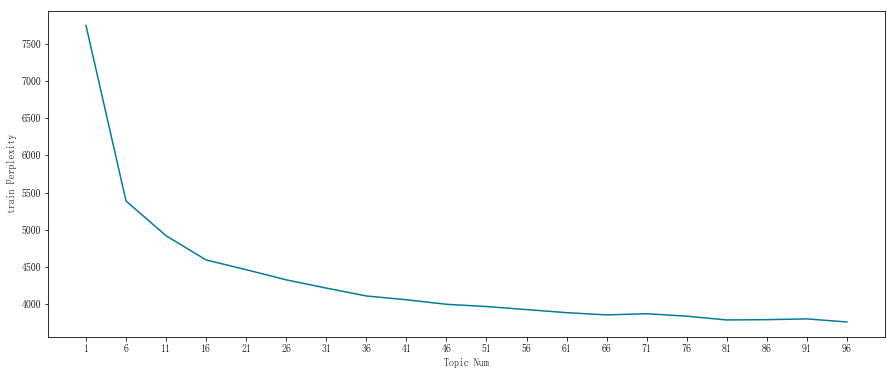

In [59]:
plt.figure(figsize=(15,6))
#plt.subplot(221)
plt.plot(df.columns.values, df.iloc[0].values, '#007A99')
plt.xticks(df.columns.values)
plt.ylabel('train Perplexity')
plt.xlabel('Topic Num')
plt.show()

# LSI(LSA)
- 潜在语义索引

## gensim

In [ ]:
lsi = models.lsimodel.LsiModel(corpus=texts, id2word=dictionary, num_topics=3)    # 初始化一个LSI转换
texts_lsi = lsi[texts_tf_idf]                # 对其在向量空间进行转换
lsi.print_topics(num_topics=3, num_words=4)